<a href="https://colab.research.google.com/github/AV-Gorshkov/Style_Image_Bot/blob/master/PY_testing_model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# реалицазия модели CNN


In [ ]:
# загрузка библиотек

import time

import os
import time
import glob
import cv2
import copy
import random

from tqdm.notebook import tqdm
from collections import defaultdict

import numpy as np

import torch
from torch import nn
import torch.nn.functional as F
import torch.optim as optim

from torchsummary import summary

import torchvision
from torchvision import transforms

from IPython.display import clear_output
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image

# import torchvision.transforms as transforms
import torchvision.models as models

%matplotlib inline

from google.colab import drive
drive.mount("/content/drive")

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

print(device)

# контроль предупреждений
import warnings
warnings.simplefilter("ignore")


Mounted at /content/drive
cpu


## загрузк данных

In [ ]:
# загрузка стилей для изображений

data_dir = r'/content/drive/My Drive/Нетология/ML/Final_Task/style/'
data_image_paths = glob.glob(f"{data_dir}/*/*.jpg")

# названия стилей помещены в словарь
dict_image = {}

for path in data_image_paths:

  if dict_image.get( path.split('/')[-2] ) is None:
    dict_image[ path.split('/')[-2] ] = [ path.split('/')[-1] ]
  else:
    dict_image[ path.split('/')[-2] ]. append(path.split('/')[-1])

dict_image

{'Impressionism': ['2.jpg', '1.jpg', '3.jpg'],
 'grisaille': ['1.jpg', '2.jpg', '3.jpg'],
 'cubism': ['1.jpg', '2.jpg', '3.jpg'],
 'post-Impressionism': ['1.jpg', '3.jpg', '2.jpg'],
 'graffiti': ['1.jpg', '2.jpg', '3.jpg'],
 'abstractionism': ['3.jpg', '1.jpg', '2.jpg'],
 'pop-art': ['3.jpg', '1.jpg', '2.jpg']}

(939, 1400)


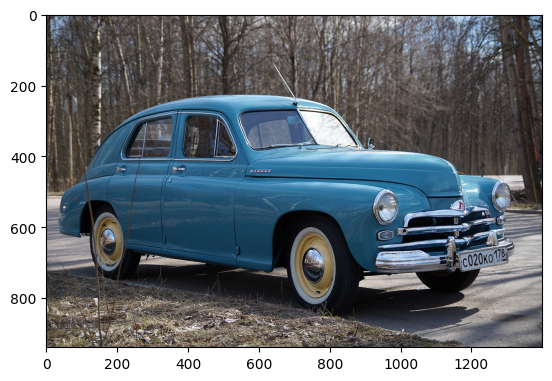

In [ ]:
# пример изображения content
#  исходного размера

file_contect = r'/content/drive/My Drive/Нетология/ML/Final_Task/test.jpg'

img_in = Image.open(file_contect)

# размер исходного изображения
i_h, i_w = img_in.size
i_size = (i_w, i_h)

print(i_size)

plt.imshow(img_in)
plt.show()

##  вспомогательные функции

In [ ]:
# преобразование изображений к одному размеру
# ограничиваем размер выходного изображения для ускорения процесса обработки
img_file = data_dir + list(dict_image.keys())[1] + '/' + dict_image[list(dict_image.keys())[1]][0]

img_style = Image.open( img_file )
height, width = img_style.size

IMG_NROWS = min(200, height)
IMG_NCOLS = int(width * IMG_NROWS / height)

imsize = (IMG_NROWS, IMG_NCOLS)
print('Output shape: %sx%s' % imsize)

Output shape: 200x302


In [ ]:
# функция для преобразования изображения в тензор

loader = transforms.Compose([
    transforms.Resize(imsize),
    transforms.ToTensor()])

def image_loader(image_name):

    image = Image.open(image_name)
    image = loader(image).unsqueeze(0)

    return image.to(device, torch.float)

In [ ]:
#  преобразование тензора в изображение

def imshow(tensor, title=None):

    unloader = transforms.ToPILImage()

    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = unloader(image)
    plt.imshow(image)

    if title is not None:
        plt.title(title)

In [ ]:
# возврат изображения в исходный размер из тензоза

def resize_loader(image):

      uloader = transforms.Compose([
              transforms.Resize(i_size)
              ])
      image = uloader(image)

      return image.to(device, torch.float)

## предобработка данных

In [ ]:
# преобразуем изображения стилей в тензоры и упакуем их в словарь

style_img = {}

for key, val in dict_image.items():

  for el in val:
   tensor_img = image_loader ( data_dir + key + '/' + el)
   if style_img.get( key ) is None:
      style_img[ key ] = [ tensor_img]
   else:
      style_img[ key ]. append( tensor_img )

# пример тензора
style_img['cubism'][1][0]

tensor([[[0.4588, 0.5333, 0.5647,  ..., 0.4392, 0.4353, 0.4314],
         [0.4863, 0.5490, 0.5647,  ..., 0.4392, 0.4353, 0.4314],
         [0.5020, 0.5529, 0.5451,  ..., 0.4392, 0.4353, 0.4314],
         ...,
         [0.0549, 0.0549, 0.0588,  ..., 0.0471, 0.0588, 0.0706],
         [0.0431, 0.0431, 0.0471,  ..., 0.0745, 0.1098, 0.1765],
         [0.0275, 0.0314, 0.0353,  ..., 0.0471, 0.0902, 0.2039]],

        [[0.6000, 0.6824, 0.7333,  ..., 0.6510, 0.6471, 0.6431],
         [0.6314, 0.7059, 0.7373,  ..., 0.6510, 0.6471, 0.6431],
         [0.6588, 0.7176, 0.7294,  ..., 0.6510, 0.6471, 0.6431],
         ...,
         [0.0902, 0.0902, 0.0941,  ..., 0.0157, 0.0196, 0.0314],
         [0.0784, 0.0784, 0.0824,  ..., 0.0431, 0.0745, 0.1412],
         [0.0627, 0.0667, 0.0706,  ..., 0.0157, 0.0588, 0.1686]],

        [[0.7333, 0.8118, 0.8588,  ..., 0.7843, 0.7804, 0.7765],
         [0.7647, 0.8353, 0.8588,  ..., 0.7843, 0.7804, 0.7765],
         [0.7843, 0.8431, 0.8471,  ..., 0.7843, 0.7804, 0.

In [ ]:
# название ключей словаря стилей
style_img.keys()

dict_keys(['Impressionism', 'grisaille', 'cubism', 'post-Impressionism', 'graffiti', 'abstractionism', 'pop-art'])

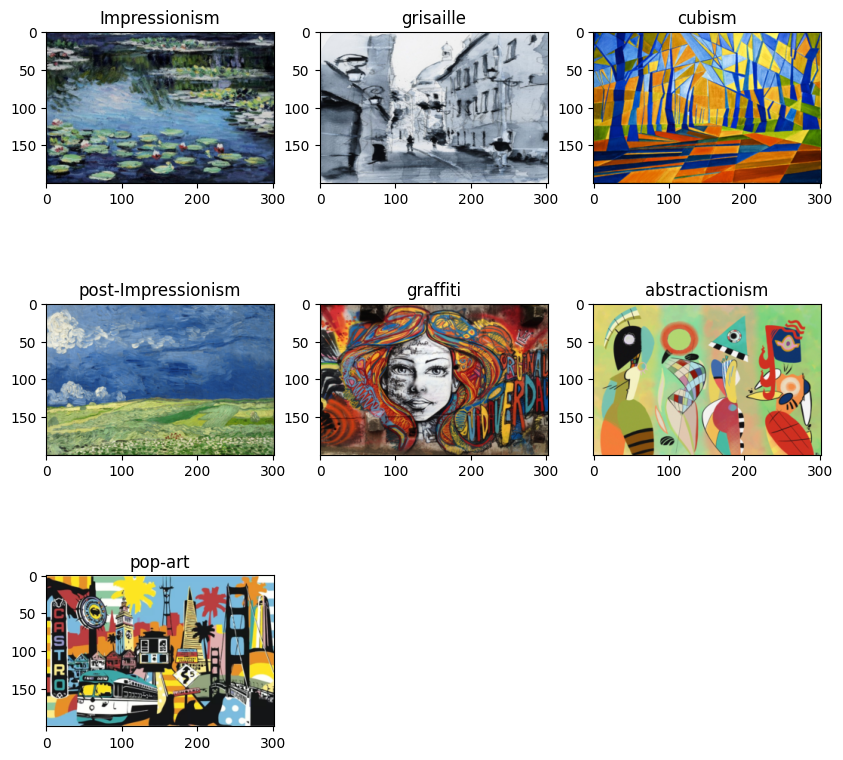

In [ ]:
# пример изображений стиля

plt.figure(figsize=(10,10))

for el, key in enumerate( style_img.keys() ):

  n = random.randint(0, 2)
  plt.subplot(3, 3, int(el) + 1)
  imshow (style_img[key][n], key)

plt.show()

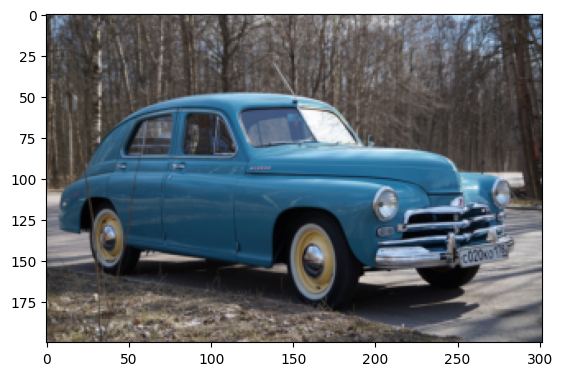

In [ ]:
# пример изображения content
# в уменьшенном виде
file_contect = r'/content/drive/My Drive/Нетология/ML/Final_Task/test.jpg'

# перевод изображения в тензор
img_content = image_loader (file_contect)
# пример изображения
imshow (img_content)
plt.show()

torch.Size([1, 3, 200, 302])
torch.Size([1, 3, 939, 1400])


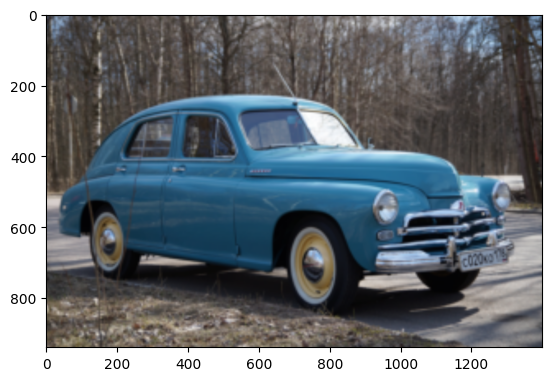

In [ ]:
#  изображение content в исходном виде

print(img_content.shape)

img_2 = resize_loader(img_content)

print(img_2.shape)
imshow (img_2)
plt.show()

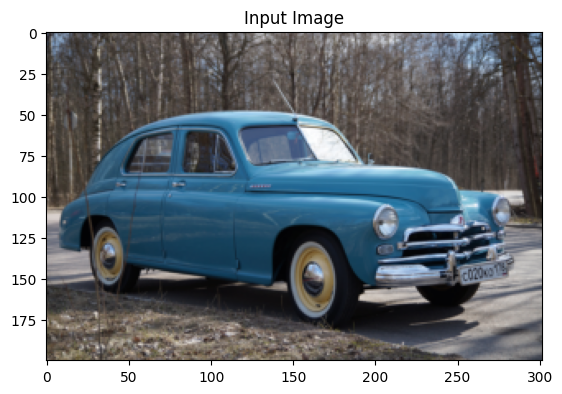

In [ ]:
# входное изображение для модели
# реализована как копия исходого изображения контента

img_input = img_content.clone()

plt.figure()
imshow(img_input, title='Input Image')

## вспомогательные функции для модели CNN

In [ ]:
#  подсчет loss для исходного изображения

class ContentLoss(nn.Module):

    def __init__(self, target,):
        super(ContentLoss, self).__init__()

        self.target = target.detach()

    def forward(self, input):
        self.loss = F.mse_loss(input, self.target)
        return input

In [ ]:
# Функция потерь для стиля
# матрица Грама

def gram_matrix(input):

    a, b, c, d = input.size()
    # a - размер батча size=1
    # b - кол-в карт
    # c,d - размер

    features = input.view(a * b, c * d)

    G = torch.mm(features, features.t())
    # произведение по Граму
    #  нормализуем значения матрицы грамма
    # деления на количество элементов в каждой карте объектов.

    return G.div(a * b * c * d)

In [ ]:
#  подсчет loss для изображения стиля

class StyleLoss(nn.Module):

    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.target = gram_matrix(target_feature).detach()

    def forward(self, input):
        G = gram_matrix(input)
        self.loss = F.mse_loss(G, self.target)
        return input

In [ ]:
# нормализация тензора изображений для обучения модели

cnn_normalization_mean = torch.tensor([0.485, 0.456, 0.406]).to(device)
cnn_normalization_std = torch.tensor([0.229, 0.224, 0.225]).to(device)

class Normalization(nn.Module):
    def __init__(self, mean, std):
        super(Normalization, self).__init__()

        self.mean = torch.tensor(mean).view(-1, 1, 1)
        self.std = torch.tensor(std).view(-1, 1, 1)

    def forward(self, img):

        return (img - self.mean) / self.std

In [ ]:
# загрузка модели vgg19

model_vgg = models.vgg19(pretrained=True).features.to(device).eval()

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:05<00:00, 98.3MB/s]


In [ ]:
#  архитектура модели
print(model_vgg)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
# функция, которая рассчитывает признаки стиля и контента
# функция будет предварительно подгружать и обрабатывать содержимое и стиль.
# затем эти представления пройдут через сеть, чтобы получить промежуточные слои.

#  слой контент
content_layers = ['conv_5']

# слой стиля
style_layers = ['conv_1',
                'conv_2',
                'conv_3',
                'conv_4',
                'conv_5'
               ]

def get_style_model_and_losses(cnn, normalization_mean, normalization_std,
                               style_img, content_img,
                               content_layers=content_layers,
                               style_layers=style_layers):
    cnn = copy.deepcopy(cnn)

    normalization = Normalization(normalization_mean, normalization_std).to(device)

    content_losses = []
    style_losses = []

    model = nn.Sequential(normalization)

    i = 0
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_{}'.format(i)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_{}'.format(i)
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_{}'.format(i)
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_{}'.format(i)
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        model.add_module(name, layer)

        if name in content_layers:

            target = model(content_img).detach()
            content_loss = ContentLoss(target)
            model.add_module("content_loss_{}".format(i), content_loss)
            content_losses.append(content_loss)

        if name in style_layers:

            target_feature = model(style_img).detach()
            style_loss = StyleLoss(target_feature)
            model.add_module("style_loss_{}".format(i), style_loss)
            style_losses.append(style_loss)

    for i in range(len(model) - 1, -1, -1):
        if isinstance(model[i], ContentLoss) or isinstance(model[i], StyleLoss):
            break

    model = model[:(i + 1)]

    return model, style_losses, content_losses

In [ ]:
#  оптимизатор

def get_input_optimizer(input_img):
    optimizer = optim.Adam([input_img.requires_grad_()])

    return optimizer

In [ ]:
# обучение модели (процесс переноса стиля)

def run_style_transfer(cnn, normalization_mean, normalization_std,
                       content_img, style_img, input_img, num_steps=50,
                       style_weight=1000000, content_weight=1):

# получение представлений признаков стиля и контента (из промежуточных слоёв)
    model, style_losses, content_losses = get_style_model_and_losses(cnn,
        normalization_mean, normalization_std, style_img, content_img)

# вызов оптимизатора
    optimizer = get_input_optimizer(input_img)

    run = [0]

    while run[0] <= num_steps:

        def closure():

            global sc_style, sc_content

            input_img.data.clamp_(0, 1)

            optimizer.zero_grad()
            model(input_img)

            style_score = 0
            content_score = 0

#  подсчет Loss для слоев стиля
            for sl in style_losses:
                style_score += sl.loss

#  подсчет Loss для слоев контента
            for cl in content_losses:
                content_score += cl.loss

            style_score *= style_weight
            content_score *= content_weight

            loss = style_score + content_score
            loss.backward()

            run[0] += 1

            sc_style, sc_content =  style_score.item(), content_score.item()

            return  style_score + content_score

        optimizer.step(closure)

    input_img.data.clamp_(0, 1)

    return (input_img, sc_style, sc_content )

##  Тестирование модели и подбор оптимальных параметров
(все тесты будут проводится на CPU)

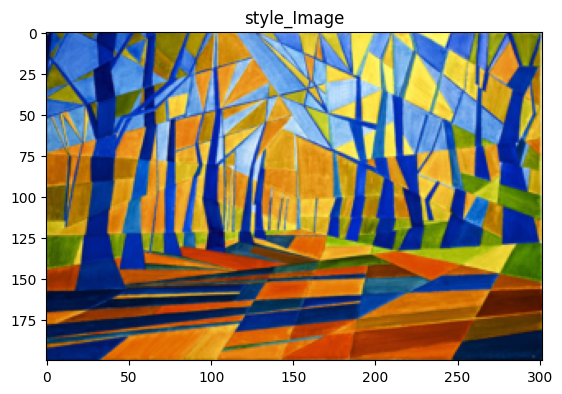

In [ ]:
#  пример изображения стиля

img_style = style_img['cubism'][0]

imshow(img_style, title='style_Image')

plt.show()

### - подбор оптимального количества итераций для переноса стиля

In [ ]:
# зафиксируем слои style и content

# слой контента
content_layers = ['conv_1']

# слой стиля
style_layers = ['conv_1',
                'conv_2',
                'conv_3',
                'conv_4',
                'conv_5'
               ]

Time: 62.86 sec


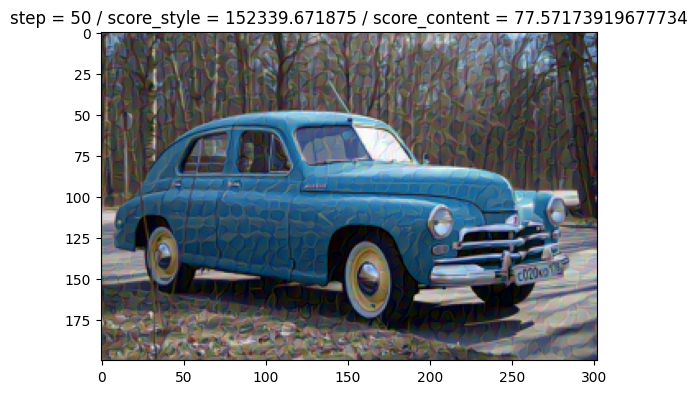

Time: 125.08 sec


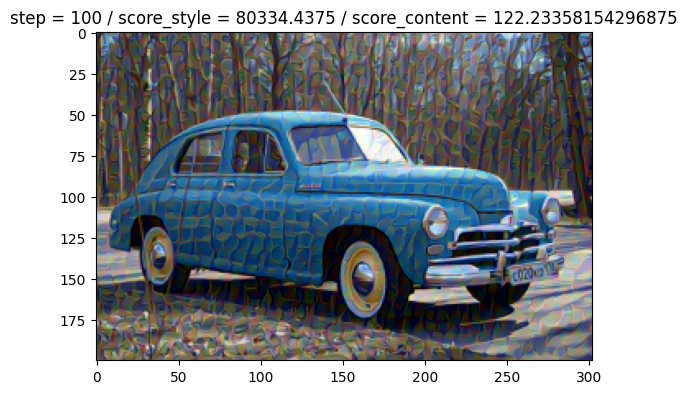

Time: 180.23 sec


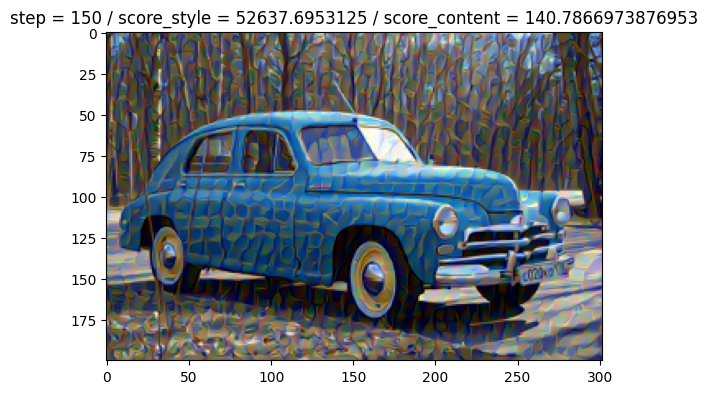

Time: 238.94 sec


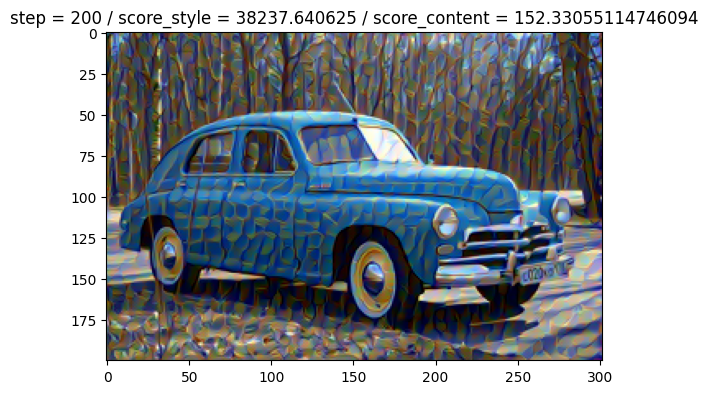

Time: 303.59 sec


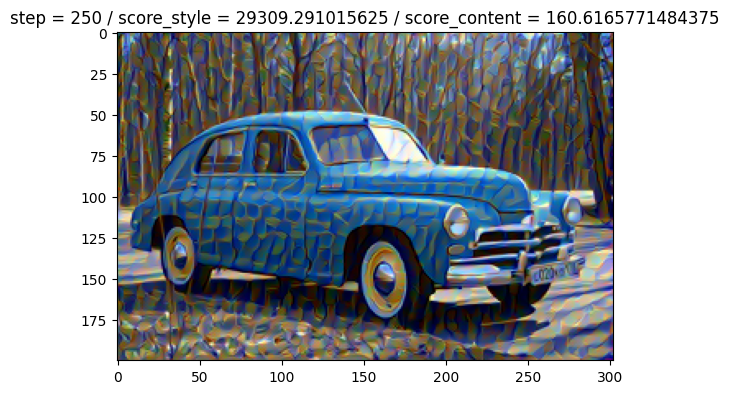

Time: 357.69 sec


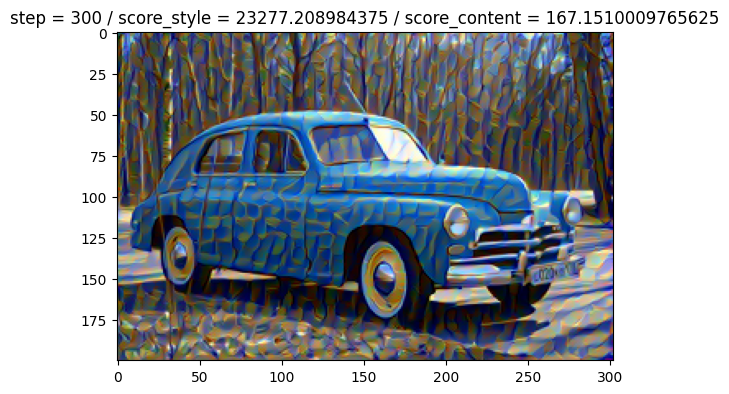

Time: 417.44 sec


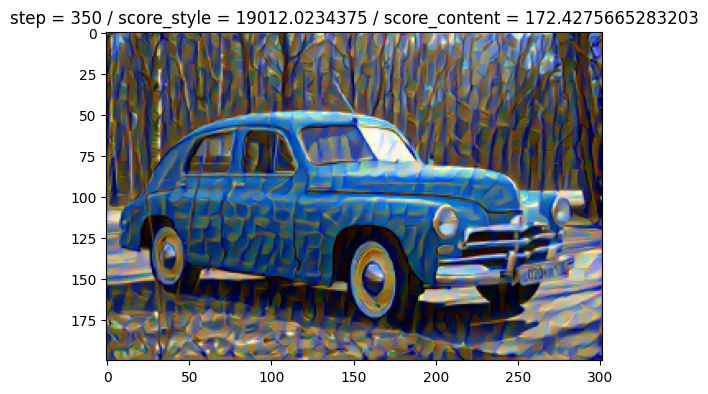

Time: 477.52 sec


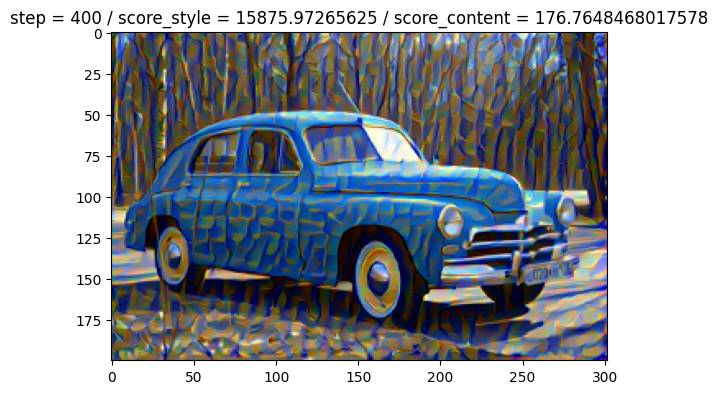

Time: 537.19 sec


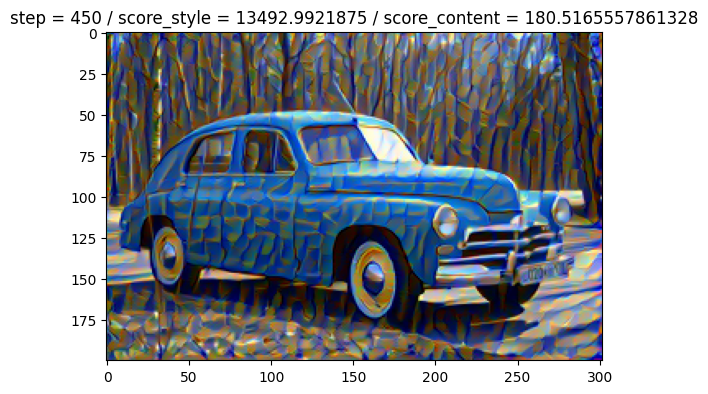

Time: 594.51 sec


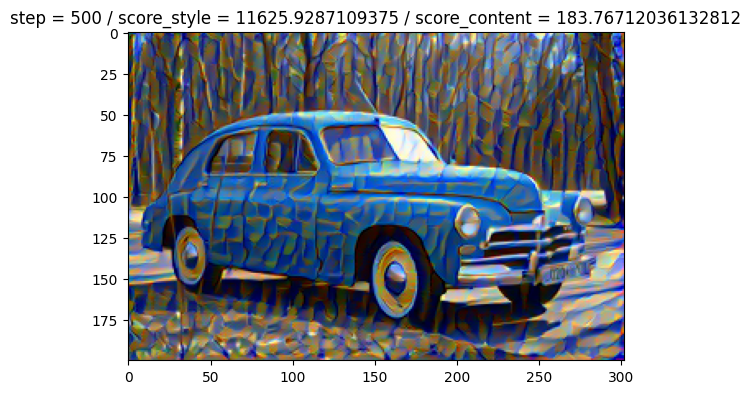

Time: 651.65 sec


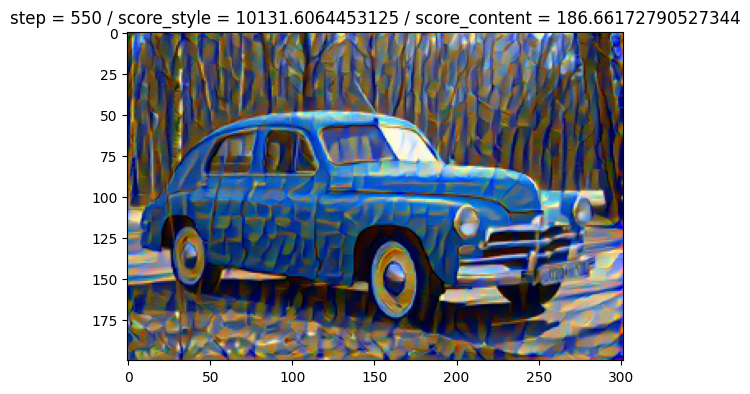

Time: 704.81 sec


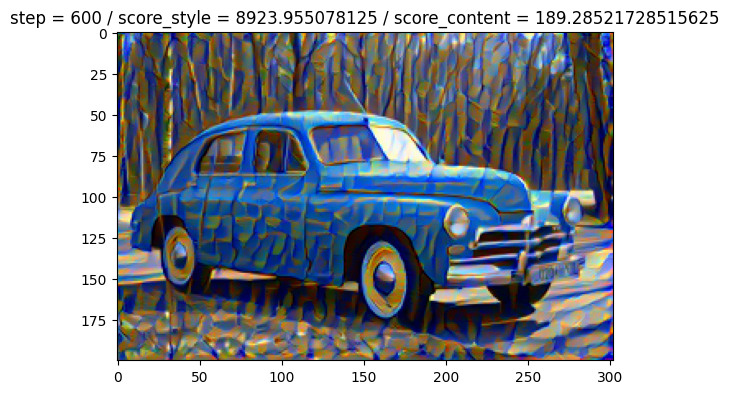

In [ ]:
#  Визуально подберем оптимальное кол-во шагов обучения модели
#  для применени стиля к исходному изображению

st = 50
fn_ = 601
n_step = 50

for n in range( st, fn_, n_step):

  img_input = img_content.clone()
  st_time = time.time()

  output, score_style, score_content = run_style_transfer( model_vgg, cnn_normalization_mean,
                                                           cnn_normalization_std, img_content,
                                                           img_style, img_input,
                                                           num_steps=n,
                                                           style_weight=1000000,
                                                           content_weight=1)

  end_time = time.time()

  txt = f'step = {n} / score_style = {score_style} / score_content = {score_content}'
  imshow(output, title=txt )

  print(f"Time: {end_time - st_time :.2f} sec")
  plt.show()

Time: 1210.28 sec
step = 1000 / score_style = 4072.79736328125 / score_content = 203.7765655517578


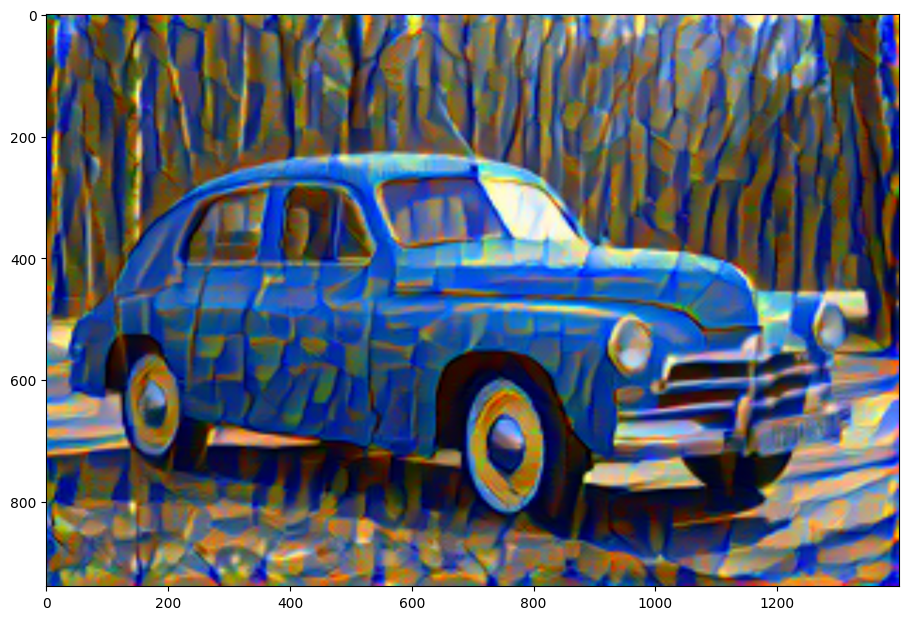

In [ ]:
# выбирем step n = 1000

st_time = time.time()
img_input = img_content.clone()

n = 1000
output, score_style, score_content = run_style_transfer( model_vgg, cnn_normalization_mean,
                                                           cnn_normalization_std, img_content,
                                                           img_style, img_input,
                                                           num_steps=n,
                                                           style_weight=1000000,
                                                           content_weight=1)

end_time = time.time()
print(f"Time: {end_time - st_time :.2f} sec")

plt.figure(figsize=(11,15) )
txt = f'step = {n} / score_style = {score_style} / score_content = {score_content}'

print(txt)

# преобразование изображение в исходный размер
img_resize = resize_loader(output)
imshow (img_resize)

plt.show()

### - подбор оптимального слоя в модели для переноса стиля



In [ ]:
#  выбор слоя style/content в модели

# слой контента
list_cont = ['conv_1', 'conv_3','conv_5']

# слой стиля
style_layers= ['conv_1',
               'conv_2',
               'conv_3',
               'conv_4',
               'conv_5'  ]

Time: 707.18 sec
 content_layers = conv_1
step = 1000 / score_style = 4072.79736328125 / score_content = 203.7765655517578


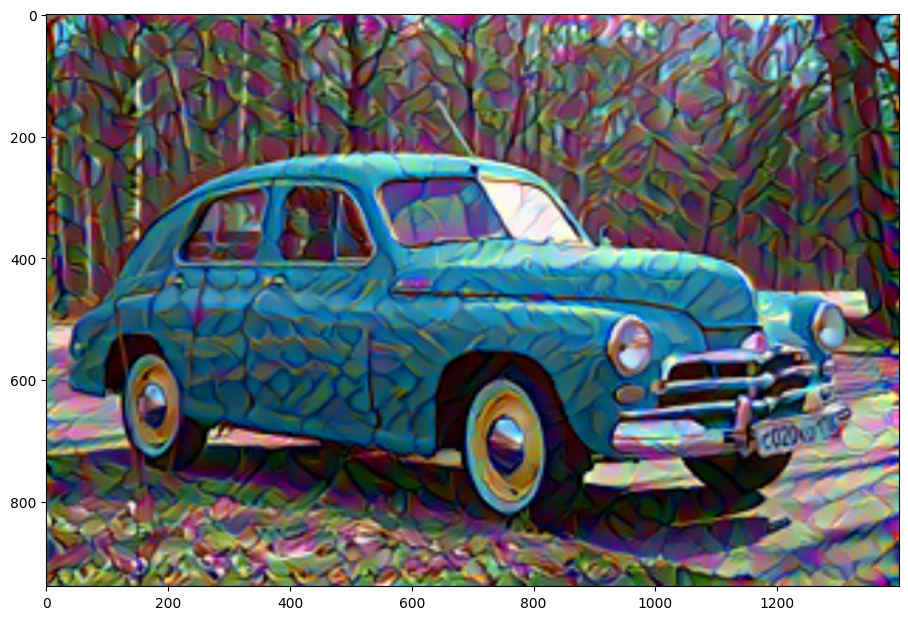

Time: 711.15 sec
 content_layers = conv_3
step = 1000 / score_style = 4072.79736328125 / score_content = 203.7765655517578


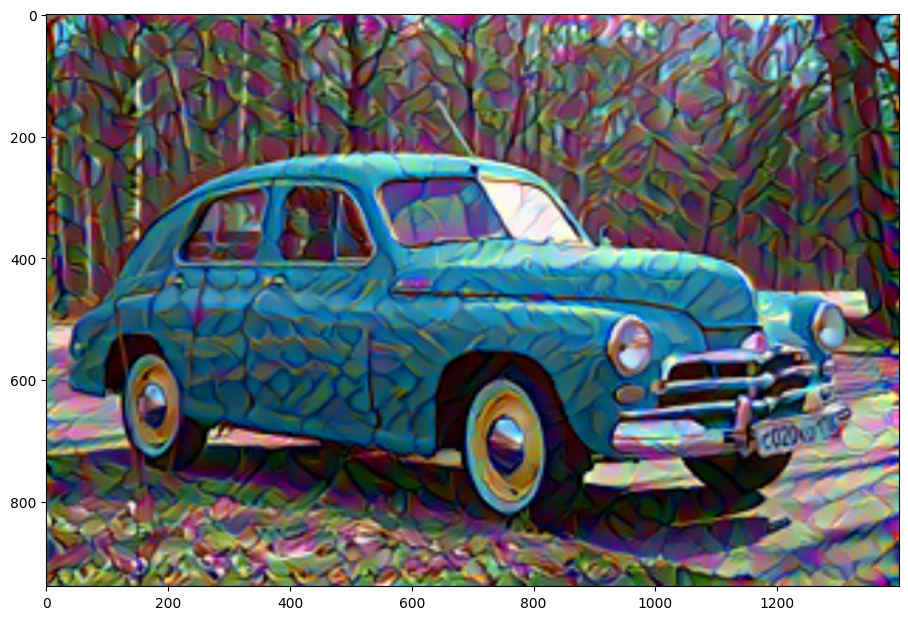

Time: 712.94 sec
 content_layers = conv_5
step = 1000 / score_style = 4072.79736328125 / score_content = 203.7765655517578


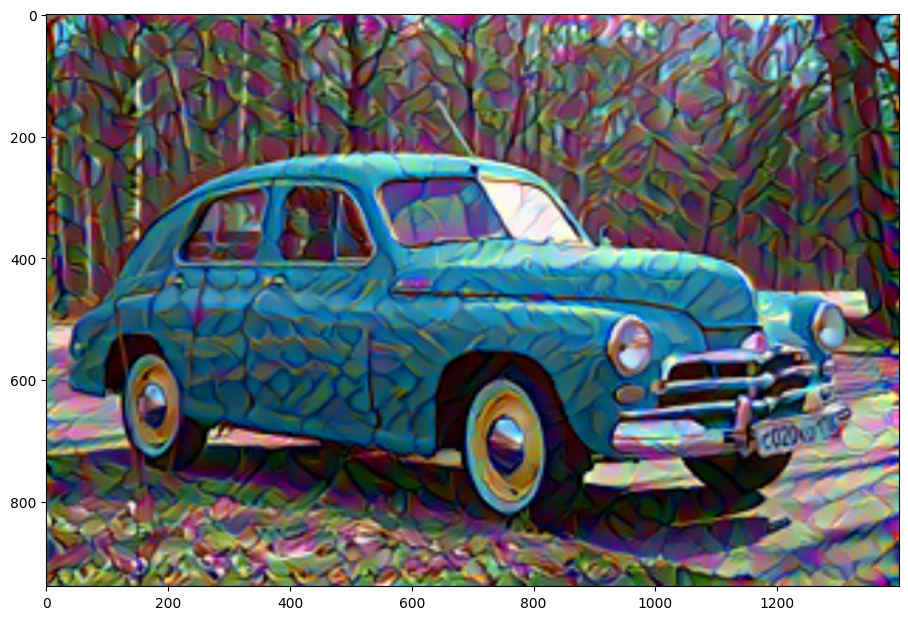

In [ ]:
n = 1000

for content in list_cont:

  content_layers = content
  img_input = img_content.clone()
  st_time = time.time()

  output, score_style, score_content = run_style_transfer( model_vgg, cnn_normalization_mean,
                                                           cnn_normalization_std, img_content,
                                                           img_style, img_input,
                                                           num_steps=n,
                                                           style_weight=1000000,
                                                           content_weight=1)

  end_time = time.time()

  print(f"Time: {end_time - st_time :.2f} sec")
  print( f' content_layers = {content_layers}')

  plt.figure(figsize=(11,15) )

  print(txt)
  img_out = resize_loader(output)

  imshow (img_out)

  plt.show()

In [ ]:
#  расположениея стиля content_layers в модели на разных уровнях,
#  визуально мало различим.
# оставим параметры для модели

#  кол-во шагов итерации
n = 600

#  слои для модели

# слой контента
content_layers = ['conv_5']

# слой стиля
style_layers= ['conv_1',
               'conv_2',
               'conv_3',
               'conv_4',
               'conv_5'
               ]

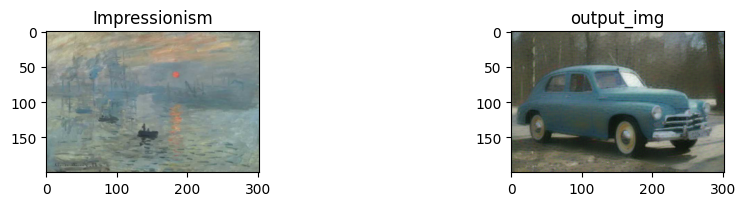

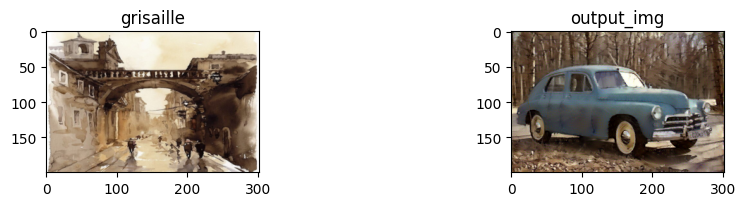

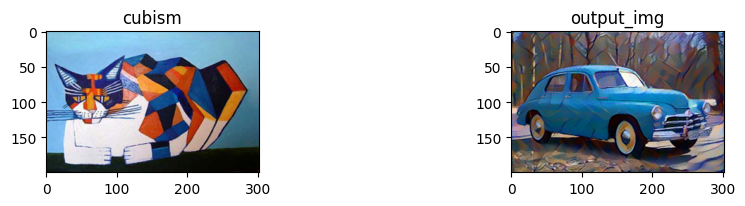

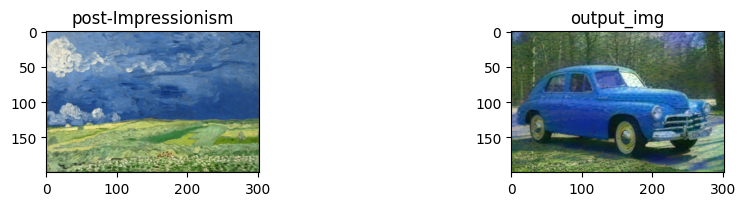

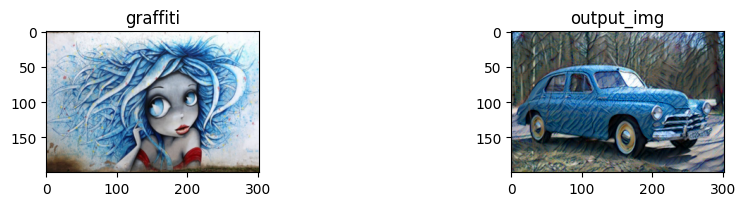

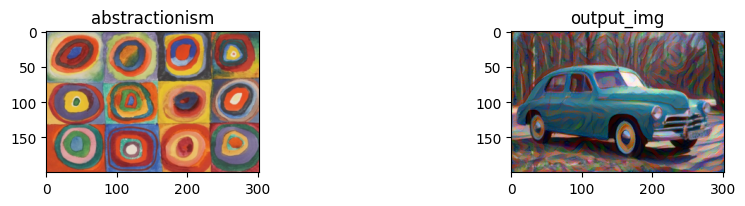

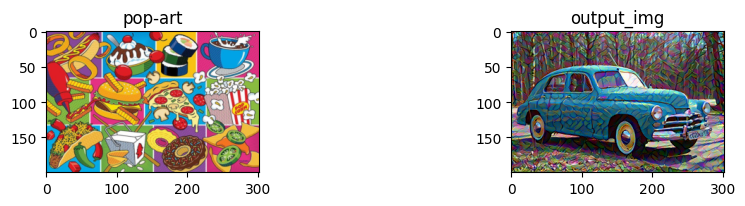

In [ ]:
# тест применения различных стилей к изображению "контент"

for el, key in enumerate( style_img.keys() ):

  n_img = random.randint(0, 2)
  img_style = style_img[key][n_img]

  img_input = img_content.clone()

  output, score_style, score_content = run_style_transfer( model_vgg, cnn_normalization_mean,
                                                           cnn_normalization_std, img_content,
                                                           img_style, img_input,
                                                           num_steps=n,
                                                           style_weight=1000000,
                                                           content_weight=1)

  plt.figure(figsize=(11,15) )

  plt.subplot(7, 2, int(el) * 2 + 1)
  txt_1 = key
  imshow(img_style, title=txt_1 )

  plt.subplot(7, 2, int(el) * 2 + 2)
  txt_2 = 'output_img'
  imshow(output, title=txt_2 )

plt.show()

## Тестирование модели на графическом процессоре (GPU)

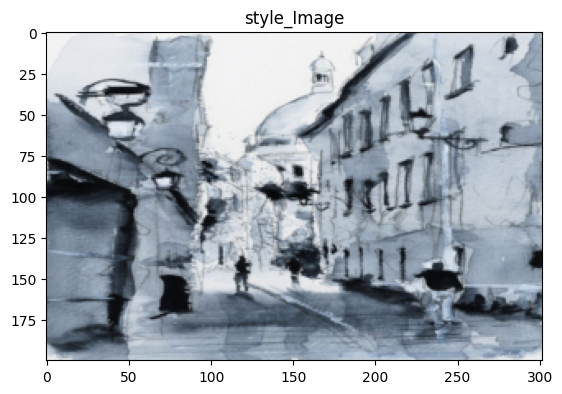

In [ ]:
#  пример изображения стиля

img_style = style_img['grisaille'][0]
imshow(img_style, title='style_Image')
plt.show()

cuda
Time: 7.83 sec


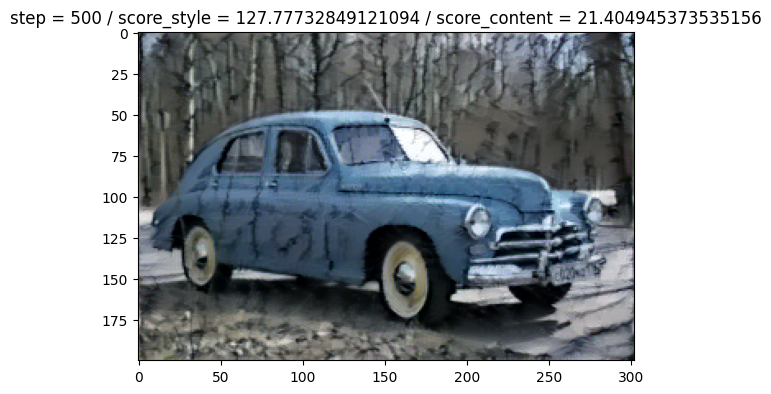

Time: 17.50 sec


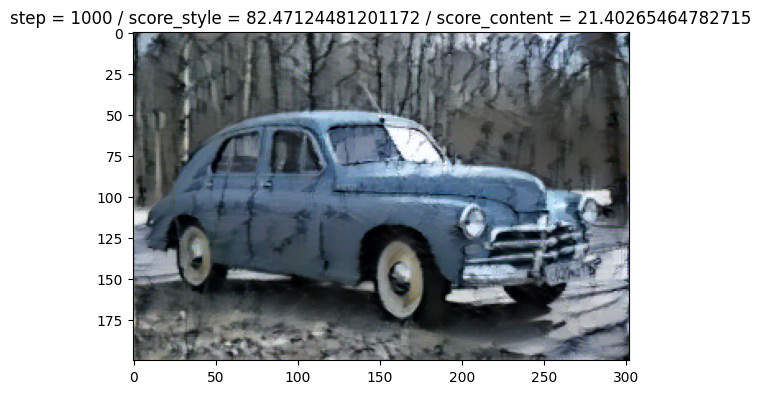

Time: 22.80 sec


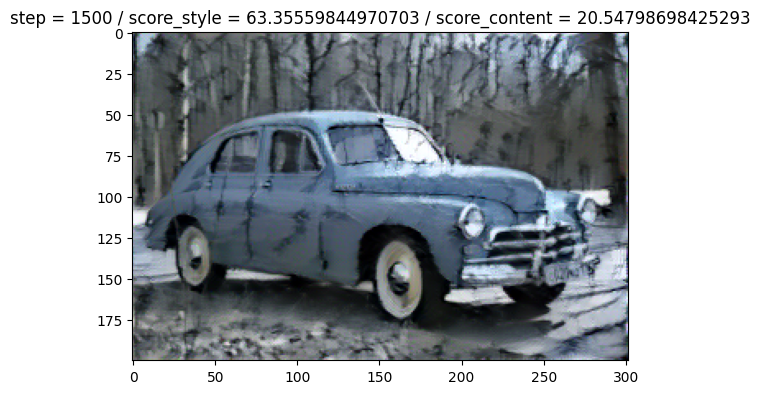

Time: 30.75 sec


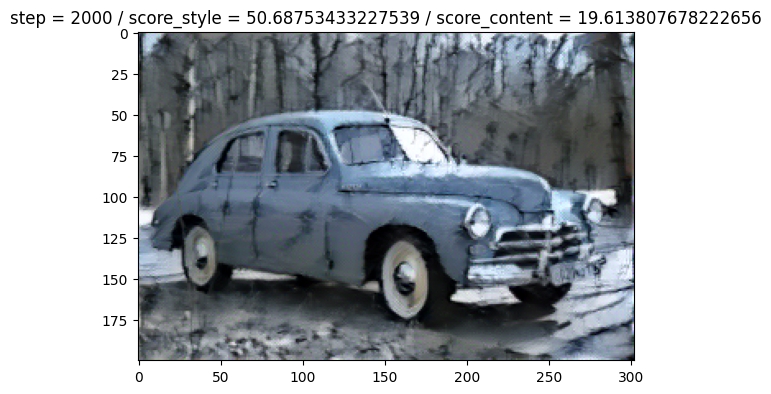

Time: 37.80 sec


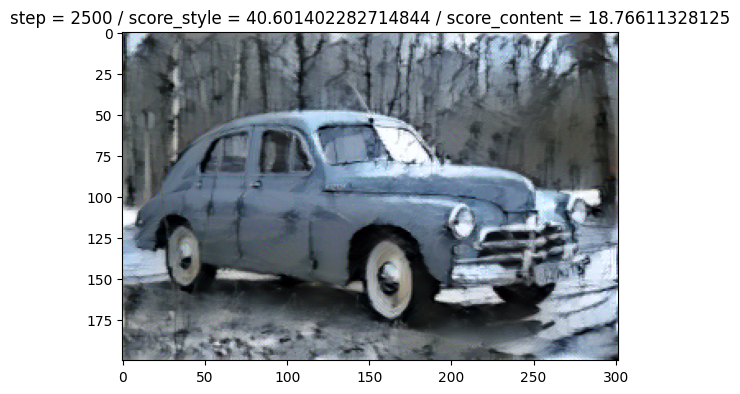

Time: 45.45 sec


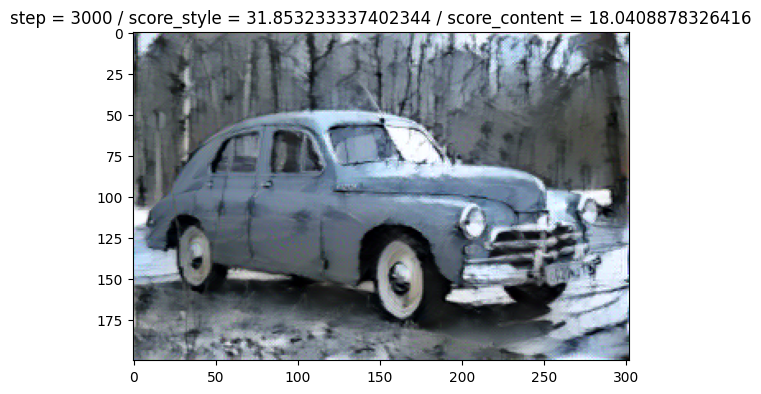

Time: 52.77 sec


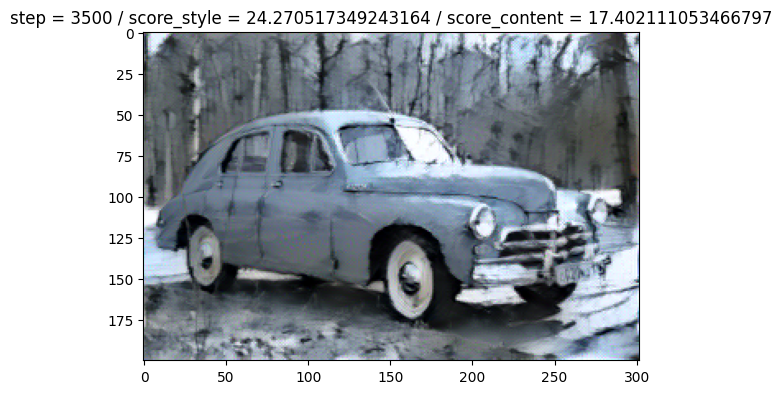

Time: 60.36 sec


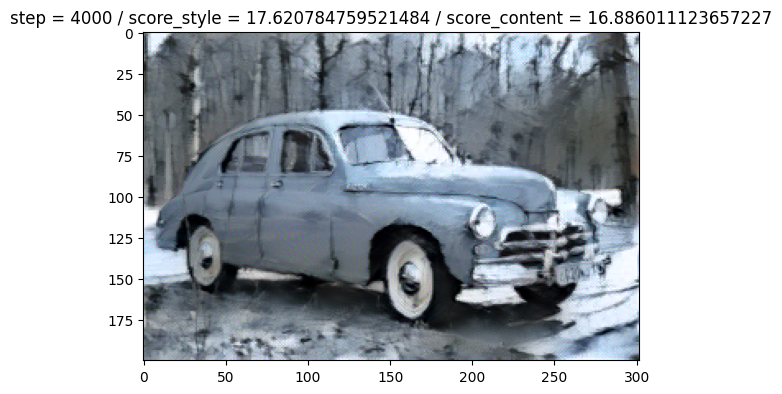

Time: 68.01 sec


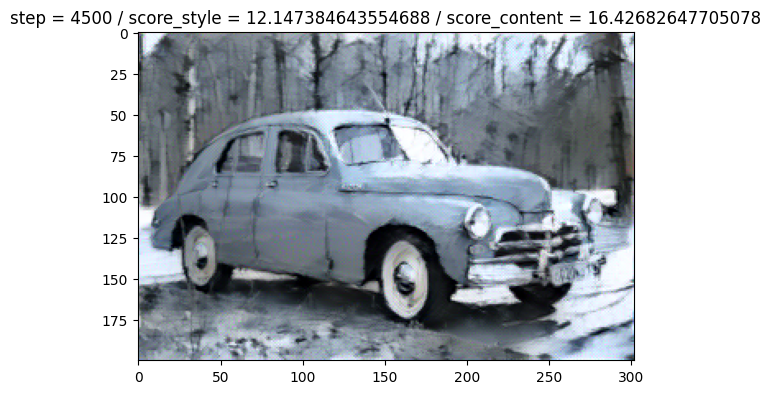

Time: 75.58 sec


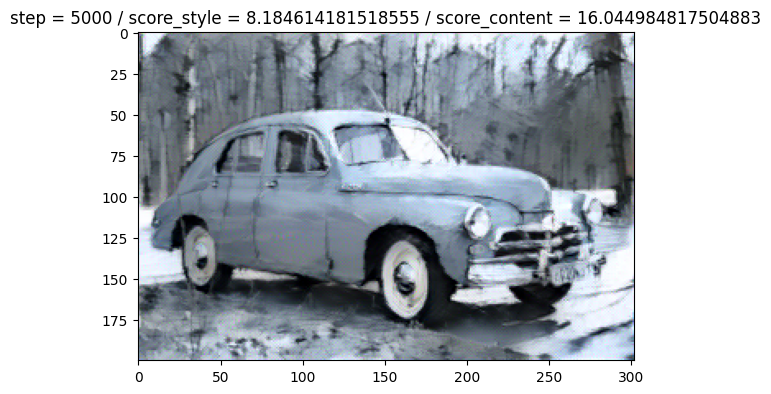

Time: 83.08 sec


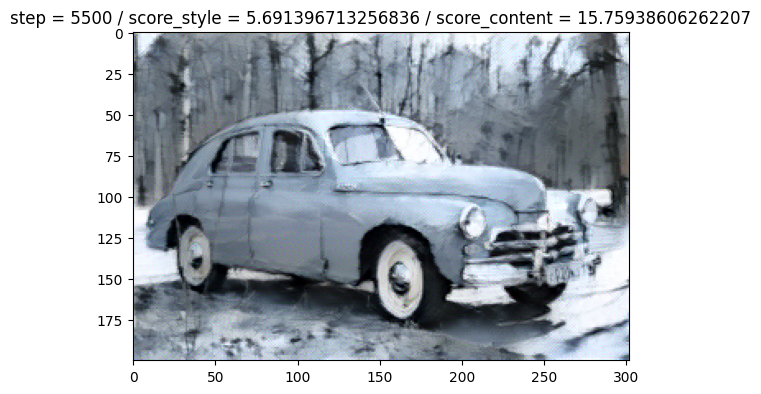

Time: 90.56 sec


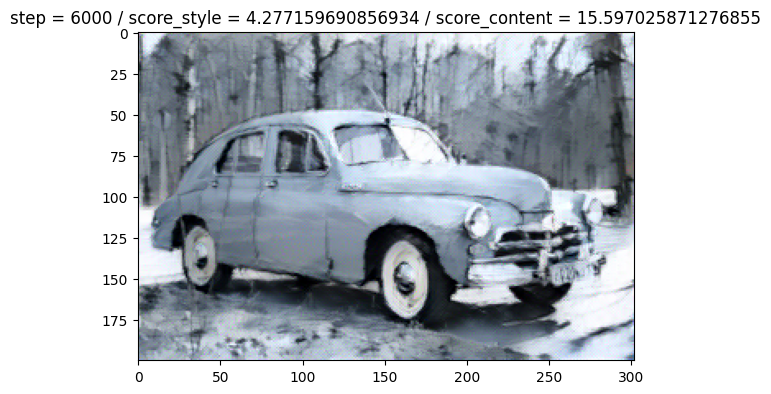

In [ ]:
print( device)

n_step = [500, 1000, 1500, 2000, 2500, 3000, 3500, 4000, 4500, 5000, 5500, 6000]

for n in n_step:

  img_input = img_content.clone()
  st_time = time.time()

  output, score_style, score_content = run_style_transfer( model_vgg, cnn_normalization_mean,
                                                           cnn_normalization_std, img_content,
                                                           img_style, img_input,
                                                           num_steps=n,
                                                           style_weight=1000000,
                                                           content_weight=1)

  end_time = time.time()

  txt = f'step = {n} / score_style = {score_style} / score_content = {score_content}'
  imshow(output, title=txt )

  print(f"Time: {end_time - st_time :.2f} sec")
  plt.show()